# A tutorial of automated colorisation using UNet with GAN in Keras

Author: Jiarong Li
Contributor: Jiaolin Luo

A PyTroch ref: https://github.com/moein-shariatnia/Deep-Learning/tree/main/Image%20Colorization%20Tutorial

UNet at Keras: https://keras.io/examples/vision/oxford_pets_image_segmentation/

# Importing libraries

In [1]:
import tensorflow as tf
from tensorflow import keras

#!pip3 install tensorflow_datasets
#import tensorflow_datasets as tfds

import numpy as np
import matplotlib.pyplot as plt

import os
from PIL import Image
from skimage.color import lab2rgb, rgb2lab
from tensorflow.keras.preprocessing.image import img_to_array, load_img

# Setting random seed

In [2]:
#np.random.seed(192107)

In [3]:
gpus = tf.config.experimental.list_physical_devices('GPU')
gpus

[]

# Mounting Google drive (if use colab)

In [4]:
#from google.colab import drive
#drive.mount('/content/drive')

In [5]:
#!ls /content/drive/datasets

# Configurations

In [6]:
dataset_root = "datasets"
#dataset_root = "/kaggle/input"
#dataset_root = "/content/drive/MyDrive/datasets" #colab

image_size = 256
batch_size = 16

# Training image augmenter

In [7]:
from tensorflow.keras.layers.experimental import preprocessing as keras_preprocessing_layers

class ImageColorisationAugmenter(keras.layers.Layer):
    def __init__(self,
                 image_size,
                 **kwargs):
        
        self.model = keras.Sequential([
                             
              #keras_preprocessizng_layers.Resizing(
              #      int(image_size * 1.6), 
              #      int(image_size * 1.6), 
              #      interpolation = "bilinear"),
            
              #keras_preprocessing_layers.RandomZoom(
              #                          height_factor = 0.3, 
              #                          width_factor = 0.3,
              #                      ),
            
              keras_preprocessing_layers.RandomCrop(
                                        image_size, 
                                        image_size,
                                    )

             ],
             name = "imgaug_model")

        super(ImageColorisationAugmenter, self).__init__(**kwargs)

    def get_config(self):
        config = super().get_config()
        
        config['model'] = self.model

        return config

    def call(self, X_L, training = True):
        #if training:
        X_L_ = self.model(X_L)
        
        return X_L_
        
    @classmethod
    def from_config(cls, config):
        return cls(**config)

# Customised training data generator

The reason is that if we load all images as X and Y into the memory, the training data may occupy the memory up to dozens of GBs. With a customised data generator, all images fed into the GAN are on-demand without occupying too much memory.

In [8]:
class ImageColorisationDataGenerator(keras.utils.Sequence):
 
    def __init__(self, 
                 dataset_path, 
                 batch_size, 
                 image_size,
                 training = True,
                 shuffle = True):
        
        self.training = training
        self.image_size = image_size
        self.dataset_path = dataset_path
        self.batch_size = batch_size
        self.shuffle = shuffle
        self.image_augmenter = ImageColorisationAugmenter(image_size = image_size)
        self.image_files = self.get_image_files(dataset_path)
        self.indices = np.random.permutation(len(self.image_files))
        
        self.n = 0
        
        self.on_epoch_end()
      
    def get_image_files(self, dataset_path):
        
        suffixes = (".tif", ".gif", ".png", ".jpg", ".bmp")
        
        imgfiles = []
        
        for root, dirs, files in os.walk(dataset_path, topdown = True):
            for name in files:
                imgfile = os.path.join(root, name)
                if not name.startswith(".") and name.endswith(suffixes):
                    imgfiles.append(imgfile)
    
        imgfiles = sorted(imgfiles)
        
        return np.array(imgfiles)
        
    def __len__(self):
        return len(self.indices) // self.batch_size
    
    
    def load_image(self, imgfile, image_size):
        
        if self.training:
            image_size_ = int(image_size * 1.5)
        else:
            image_size_ = image_size
            
        img_rgb = keras.preprocessing.image.load_img(
                           path = imgfile, 
                           grayscale = False, 
                           color_mode = 'rgb',
                           interpolation = 'bicubic',
                           target_size = (image_size_, image_size_))
        
        img_rgb = np.asarray(img_rgb)
        
        if self.training:
            img_rgb = img_rgb.reshape(1, image_size_, image_size_, 3)
            img_rgb_imgaug_ = self.image_augmenter(img_rgb)
            img_rgb_imgaug = img_rgb_imgaug_.numpy().reshape(image_size, image_size, 3)
        else:
            img_rgb_imgaug = img_rgb
            
        return img_rgb_imgaug
    
    def __getitem__(self, idx):
        
        indices_ = self.indices[idx * self.batch_size:
                                (idx + 1) * self.batch_size]
        
        #print(len(indices_))
        
        imgfiles = self.image_files[indices_]
        
        #print(len(imgfiles))
        
        X_rgb = [self.load_image(imgfile, self.image_size) for imgfile in imgfiles]
        
        X_rgb = np.asarray(X_rgb)
        
        #print(X_rgb.shape)
        
        X_rgb_norm = X_rgb / 255.
        
        X_Lab = rgb2lab(X_rgb_norm)
        
        X_L = X_Lab[:,:,:,0].reshape(-1, self.image_size, self.image_size, 1)
        X_ab = X_Lab[:,:,:,1:].reshape(-1, self.image_size, self.image_size, 2)
        
        # to [-1, +1]
        X_L_norm = X_L / 50. - 1
        X_ab_norm = X_ab / 110.
        
        #print("datagen: idx = ", idx)
        #print("datagen: X_L.shape = ", X_L.shape)
        #print("datagen: X_ab.shape = ", X_ab.shape)
        
        return X_L_norm, X_ab_norm
        
    def on_epoch_end(self):
        
        if self.shuffle: 
            np.random.shuffle(self.indices)

# Creating a training data generator

In [9]:
batch_size

16

In [10]:
dataset_path = dataset_root + os.sep + "colorisation_train_images"

train_datagen = ImageColorisationDataGenerator(
                                  dataset_path = dataset_path,
                                  batch_size = batch_size,
                                  image_size = image_size,
                                  training = True,
                                )

In [11]:
x, y = next(iter(train_datagen))

print(x.shape)
print(y.shape)

(16, 256, 256, 1)
(16, 256, 256, 2)


# Plotting samples

In [12]:
def combine_L_and_ab(X_L, X_ab, image_size):
    
    batch_size = X_L.shape[0]
    
    # Combining L + ab to Lab images
    X_Lab = np.zeros((batch_size, image_size, image_size, 3))

    X_Lab[:, :, :, 0] = X_L.reshape(batch_size, image_size, image_size)
    X_Lab[:, :, :, 1:] = X_ab.reshape(batch_size, image_size, image_size, 2)

    return X_Lab

In [13]:
X_L_norm, X_ab_norm = next(iter(train_datagen))

X_L = (X_L_norm + 1)* 50.
X_ab = X_ab_norm * 110.

X_Lab = combine_L_and_ab(X_L, X_ab, image_size)

X_rgb = np.uint8(lab2rgb(X_Lab) * 255)

In [14]:
np.min(X_ab[0])

-0.0024549378620508655

In [15]:
np.max(X_ab[1])

56.80057103632927

In [16]:
X_rgb.shape

(16, 256, 256, 3)

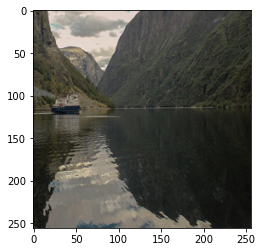

In [17]:
plt.imshow(X_rgb[3])

In [18]:
X_L.shape

(16, 256, 256, 1)

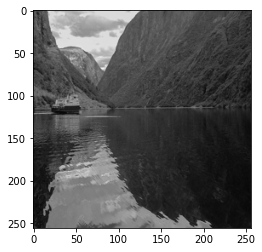

In [19]:
plt.imshow(X_L[3] / 100, cmap = "gray", vmin = 0, vmax = 1)

In [20]:
X_L, X_ab = next(iter(train_datagen))

In [21]:
X_L.shape

(16, 256, 256, 1)

In [22]:
X_ab.shape

(16, 256, 256, 2)

In [23]:
# The ab channels are rather feeble to visualise, thus
# we apply gamma transformation first to enhance the images

# Computing gamma adjusting of the ab to show
X_ab_norm = X_ab - np.min(X_ab)
X_ab_norm = X_ab_norm / np.max(X_ab_norm)

ab_mid = 0.5
ab_mean = np.mean(X_ab_norm)
ab_gamma = np.log(ab_mid) / np.log(ab_mean)

print("ab_mean = ", ab_mean)
print("ab_gamma = ", ab_gamma)

X_ab_gamma = np.power(X_ab_norm, ab_gamma)

X_ab_gamma = X_ab_gamma - np.min(X_ab_gamma)
X_ab_gamma = X_ab_gamma / np.max(X_ab_gamma)

#.clip(0,1).astype(np.float32)

ab_mean =  0.4575854261305942
ab_gamma =  0.8866136482071424


Text(0.5, 1.0, 'Hue spectrum from green to red')

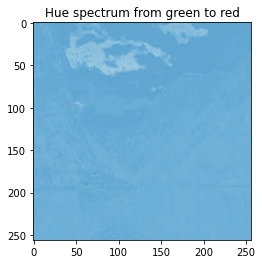

In [24]:
#plt.imshow((X_ab_[3][:,:,0] + 128) / 255., cmap = "gray", vmin = 0, vmax = 1)
plt.imshow(X_ab_gamma[3][:,:,0], cmap = "Blues", vmin = 0, vmax = 1)
#plt.contour((X_ab[3][:,:,0] + 128) / 255., colors = 'b', linewidths = 1)
plt.title("Hue spectrum from green to red")

Text(0.5, 1.0, 'Hue spectrum from blue to yellow')

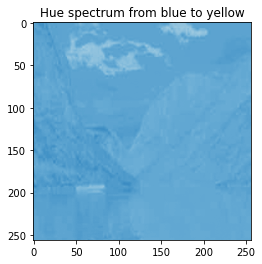

In [25]:
#plt.imshow((X_ab[3][:,:,1] + 128) / 255., cmap = "gray", vmin = 0, vmax = 1)
plt.imshow(X_ab_gamma[3][:,:,1], cmap = "Blues", vmin = 0, vmax = 1)
#plt.contour((X_ab[3][:,:,1] + 128) / 255., colors = 'b', linewidths = 1)
plt.title("Hue spectrum from blue to yellow")

# The facility of plotting dataset

In [26]:
def plot_dataset(X,
                 y,
                 normalise = True,
                 nrows = 4, 
                 ncols = 4, 
                 subfig_width = 3.8,
                 subfig_height = 3.8):
    
    indices = list(range(len(X)))
    
    replace = False
    
    if nrows * ncols > len(indices):
        replace = True
        
    indices_ = np.random.choice(indices, nrows * ncols, replace = replace)
        
    X_ = X[indices]
    y_ = y[indices]
    
    figsize = (ncols * subfig_width, nrows * subfig_height)

    fig, axes = plt.subplots(nrows = nrows,
                         ncols = ncols,
                         figsize = figsize)

    axes_flat = axes.flat 

    for row in range(nrows):
        for col in range(ncols): 
            
            idx = row * ncols + col
                
            ax = axes_flat[idx]
        
            ax.set_xticks([])
            ax.set_yticks([])
                
            imgidx = indices_[idx]
        
            image = X_[imgidx] 
            label = y_[imgidx]
            
            image = np.array(image)
                        
            #image = np.rollaxis(image, 0, 3)
                        
            if normalise:
                image = image / 255
            
            if image.shape[2] == 1:
                ax.imshow(image, cmap = "gray", vmin = 0, vmax = 1)
            else:
                ax.imshow(image, vmin = 0, vmax = 1)
                
            
                
            ax.title.set_text(f"{label}")
  
    plt.show()

# Plotting

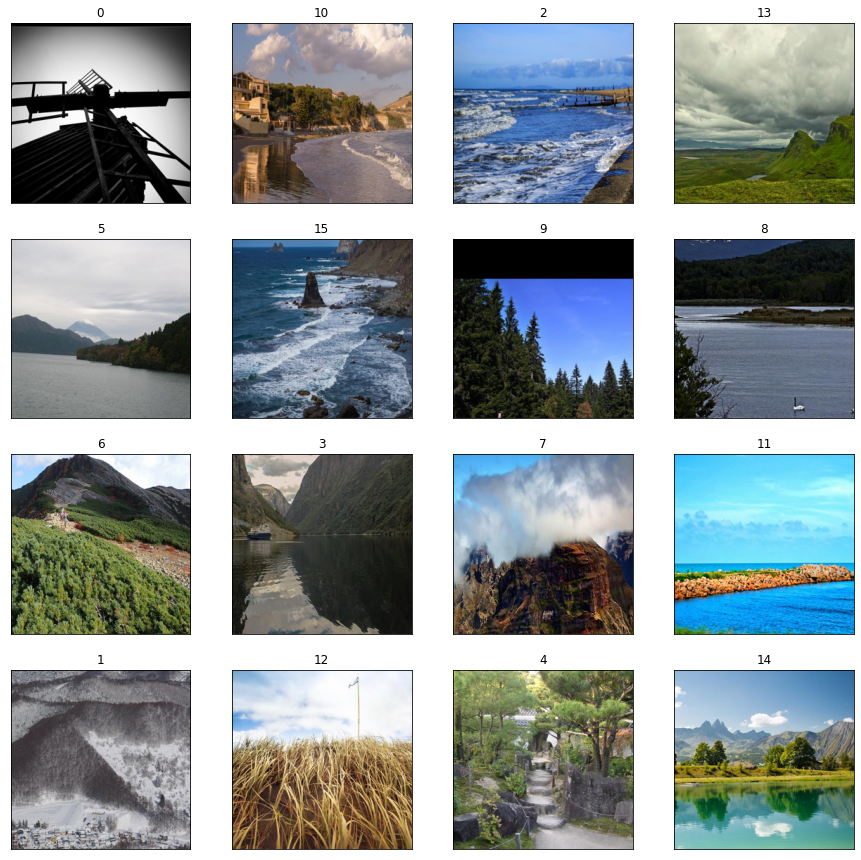

In [27]:
fake_labels = np.array(list(range(len(X_rgb))))

plot_dataset(X_rgb, fake_labels)

# Generator: U-Net layer

In [28]:
class Generator(keras.layers.Layer):
    def __init__(self, **kwargs):
        
        super(Generator, self).__init__(**kwargs)
     
        
        kernel_size = 5
        
        kernel_initializer = keras.initializers.RandomNormal(mean = 0.0, stddev = 0.02)
        #kernel_initializer = keras.initializers.RandomNormal(mean = 0.0)
        
        #Assume the input is 256x256x1
        
        #The 1st down block, the output will be 
        #128x128x32
        self.down_1 = keras.Sequential([
                    keras.layers.Conv2D(filters = 32, 
                                        kernel_size = kernel_size, 
                                        strides = 2, 
                                        padding = 'same',
                                        kernel_initializer = kernel_initializer,
                                       ),
                    keras.layers.LeakyReLU(alpha = 0.2),
                    #keras.layers.Dropout(0.1),

                    #keras.layers.Conv2D(filters = 32, 
                    #                    kernel_size = kernel_size, 
                    #                    strides = 1, 
                    #                    padding = 'same,
                    #                    kernel_initializer = kernel_initializer,
                    #                   ),
                    #keras.layers.LeakyReLU(alpha = 0.2),
                    #keras.layers.Dropout(0.1),
            
                    keras.layers.BatchNormalization(),
        ], name = "down_1")
        
        
        #The 2nd down block, the output will be 
        #64x64x64
        self.down_2 = keras.Sequential([
                    keras.layers.Conv2D(filters = 64, 
                                        kernel_size = kernel_size, 
                                        strides = 2, 
                                        padding = 'same',
                                        kernel_initializer = kernel_initializer,
                                       ),
                    keras.layers.LeakyReLU(alpha = 0.2),
                    #keras.layers.Dropout(0.3),
            
                    #keras.layers.Conv2D(filters = 64, 
                    #                    kernel_size = kernel_size, 
                    #                    strides = 1, 
                    #                    padding = 'same',
                    #                    kernel_initializer = kernel_initializer,
                    #                   ),            
                    #keras.layers.LeakyReLU(alpha = 0.2),
                    #keras.layers.Dropout(0.1),
            
                    keras.layers.BatchNormalization(),
        ], name = "down_2")
    
        
        #The 3rd down block, the output will be 
        #32x32x128
        self.down_3 = keras.Sequential([
                    keras.layers.Conv2D(filters = 128, 
                                        kernel_size = kernel_size, 
                                        strides = 2, 
                                        padding = 'same',
                                        kernel_initializer = kernel_initializer,
                                       ),                    
                    keras.layers.LeakyReLU(alpha = 0.2),
                    #keras.layers.Dropout(0.3),
            
                    #keras.layers.Conv2D(filters = 128, 
                    #                    kernel_size = kernel_size, 
                    #                    strides = 1, 
                    #                    padding = 'same',
                    #                    kernel_initializer = kernel_initializer,
                    #                   ),
                    #keras.layers.LeakyReLU(alpha = 0.2),
                    #keras.layers.Dropout(0.1),
            
                    keras.layers.BatchNormalization(),
        ], name = "down_3")
        
    
        
        #The 4th down block, the output will be 
        #16x16x256
        self.down_4 = keras.Sequential([
                    keras.layers.Conv2D(filters = 256, 
                                        kernel_size = kernel_size, 
                                        strides = 2, 
                                        padding = 'same',
                                        kernel_initializer = kernel_initializer,
                                       ),
                    keras.layers.LeakyReLU(alpha = 0.2),
                    #keras.layers.Dropout(0.3),
            
                    #keras.layers.Conv2D(filters = 256, 
                    #                    kernel_size = kernel_size, 
                    #                    strides = 1, 
                    #                    padding = 'same',
                    #                    kernel_initializer = kernel_initializer,
                    #                   ),
                    #keras.layers.LeakyReLU(alpha = 0.2),
                    #keras.layers.Dropout(0.1),
            
                    keras.layers.BatchNormalization(),                    
            
            
        ], name = "down_4")
        
       
        
        #The 5th down block, the output will be 
        #8x8x512
        self.down_5 = keras.Sequential([
                    keras.layers.Conv2D(filters = 512, 
                                        kernel_size = kernel_size, 
                                        strides = 2, 
                                        padding = 'same',
                                        kernel_initializer = kernel_initializer,
                                       ),
                    
                    keras.layers.LeakyReLU(alpha = 0.2), 
                    #keras.layers.Dropout(0.3),
            
                    #keras.layers.Conv2D(filters = 512, 
                    #                    kernel_size = kernel_size, 
                    #                    strides = 1, 
                    #                    padding = 'same',
                    #                    kernel_initializer = kernel_initializer,
                    #                   ),
                    #keras.layers.LeakyReLU(alpha = 0.2), 
                    #keras.layers.Dropout(0.1),
            
                    keras.layers.BatchNormalization(),
                           
        ], name = "down_5")
        
    
        
        #The 6th down block, the output will be 
        #8x8x1024
        self.bottleneck = keras.Sequential([
                    keras.layers.Conv2D(filters = 1024, 
                                        kernel_size = kernel_size, 
                                        strides = 1, 
                                        padding = 'same',
                                        kernel_initializer = kernel_initializer,
                                       ),
                    keras.layers.LeakyReLU(alpha = 0.2),
                    #keras.layers.Dropout(0.3),
            
                    #keras.layers.Conv2D(filters = 1024, 
                    #                    kernel_size = kernel_size, 
                    #                    strides = 1, 
                    #                    padding = 'same',
                    #                    kernel_initializer = kernel_initializer,
                    #                   ),
                    #keras.layers.LeakyReLU(alpha = 0.2),
                    #keras.layers.Dropout(0.1),
            
                    keras.layers.BatchNormalization(),
                    
                    
        ], name = "bottleneck")
        
        
         
        
        
        #The 1st up block, the output will be 
        #16x16x512
        self.up_1 = keras.Sequential([
                    keras.layers.Conv2DTranspose(filters = 512, 
                        kernel_size = kernel_size, 
                        #activation = 'relu', 
                        padding = 'same', 
                        kernel_initializer = kernel_initializer,
                        strides = 2),
                    keras.layers.LeakyReLU(alpha = 0.2),
                    #keras.layers.Dropout(0.3),
            
                    keras.layers.Conv2DTranspose(filters = 512, 
                        kernel_size = kernel_size, 
                        #activation = 'relu', 
                        padding = 'same',  
                        kernel_initializer = kernel_initializer,
                        strides = 1),
                    keras.layers.LeakyReLU(alpha = 0.2),
                    #keras.layers.Dropout(0.1),
            
                    keras.layers.BatchNormalization(),
                    
            ], name = "up_1")
        
        
        
        #The 2nd up block, the output will be 
        #32x32x256
        self.up_2 = keras.Sequential([
                    keras.layers.Conv2DTranspose(filters = 256, 
                        kernel_size = kernel_size, 
                        #activation = 'relu', 
                        padding = 'same',  
                        kernel_initializer = kernel_initializer,
                        strides = 2),
                    keras.layers.LeakyReLU(alpha = 0.2), 
                    #keras.layers.Dropout(0.3),
            
                    #keras.layers.Conv2DTranspose(filters = 256, 
                    #    kernel_size = kernel_size, 
                    #    #activation = 'relu', 
                    #    padding = 'same',  
                    #   kernel_initializer = kernel_initializer,
                    #    strides = 1),
                    #keras.layers.LeakyReLU(alpha = 0.2), 
                    #keras.layers.Dropout(0.1),
            
                    keras.layers.BatchNormalization(),
                               
        ], name = "up_2")
        
        
        
        #The 3rd up block, the output will be 
        #64x64x128
        self.up_3 = keras.Sequential([
                    keras.layers.Conv2DTranspose(filters = 128, 
                        kernel_size = kernel_size, 
                        #activation = 'relu', 
                        padding = 'same',  
                        kernel_initializer = kernel_initializer,                         
                        strides = 2),
                    keras.layers.LeakyReLU(alpha = 0.2),  
                    #keras.layers.Dropout(0.3),
            
                    #keras.layers.Conv2DTranspose(filters = 128, 
                    #    kernel_size = kernel_size, 
                    #    #activation = 'relu', 
                    #    padding = 'same', 
                    #    kernel_initializer = kernel_initializer,   
                    #    strides = 1),
                    #keras.layers.LeakyReLU(alpha = 0.2),  
                    #keras.layers.Dropout(0.1),
            
                    keras.layers.BatchNormalization(),
                              
        ], name = "up_3")
        
        
        
        #The 4th up block, the output will be 
        #128x128x64
        self.up_4 = keras.Sequential([
                    keras.layers.Conv2DTranspose(filters = 64, 
                        kernel_size = kernel_size, 
                        #activation = 'relu', 
                        padding = 'same',  
                        kernel_initializer = kernel_initializer,                           
                        strides = 2),
                    keras.layers.LeakyReLU(alpha = 0.2),
                    #keras.layers.Dropout(0.3),
            
                    #keras.layers.Conv2DTranspose(filters = 64, 
                    #    kernel_size = kernel_size, 
                    #    #activation = 'relu', 
                    #    padding = 'same', 
                    #   kernel_initializer = kernel_initializer,   
                    #    strides = 1),
                    #keras.layers.LeakyReLU(alpha = 0.2),
                    #keras.layers.Dropout(0.1),
            
                    keras.layers.BatchNormalization(),
                    
            ], name = "up_4")
        
        
        #The 5th up block, the output will be 
        #256x256x32
        self.up_5 = keras.Sequential([
                    keras.layers.Conv2DTranspose(filters = 32, 
                        kernel_size = kernel_size, 
                        #activation = 'relu', 
                        padding = 'same',
                        kernel_initializer = kernel_initializer,
                        strides = 2),
                    keras.layers.LeakyReLU(alpha = 0.2),
                    #keras.layers.Dropout(0.3),
            
                    #keras.layers.Conv2DTranspose(filters = 32, 
                    #    kernel_size = kernel_size, 
                    #    #activation = 'relu', 
                    #    padding = 'same',
                    #    kernel_initializer = kernel_initializer,   
                    #    strides = 1),
                    #keras.layers.LeakyReLU(alpha = 0.2),
                    #keras.layers.Dropout(0.1),
            
                    keras.layers.BatchNormalization(),
                    
            ], name = "up_5")
        
        
        #The final block, the output will be 
        #256x256x2
        self.final = keras.Sequential([
                    keras.layers.Conv2DTranspose(filters = 2, 
                        kernel_size = 3, 
                        activation = 'tanh', 
                        padding = 'same', 
                        kernel_initializer = kernel_initializer,   
                        strides = 1,)
            ], name = "final")
        
            
    def get_config(self):
        config = super().get_config()
        return config
    
    def call(self, inputs, training = True):   
        
        x1 = self.down_1(inputs) #128x128
        x2 = self.down_2(x1)     #64x64
        x3 = self.down_3(x2)     #32x32
        x4 = self.down_4(x3)    #16x16
        x5 = self.down_5(x4)    #8x8
        
        x = self.bottleneck(x5) #8x8
         
        x = tf.concat([x, x5], axis = 3)        
        x = self.up_1(x)
        
        x = tf.concat([x, x4], axis = 3)
        x = self.up_2(x)
        
        x = tf.concat([x, x3], axis = 3) #64x64
        x = self.up_3(x)
        
        x = tf.concat([x, x2], axis = 3) #128x128
        x = self.up_4(x)
        
        x = tf.concat([x, x1], axis = 3)#256x256
        x = self.up_5(x)
        
        x = self.final(x) #256x256x2

        return x

# Testing the U-Net layer

In [29]:
layer = Generator()

x = np.random.rand(1, image_size, image_size, 1)
#x = X_train[0].reshape(1, image_size, image_size, 1)

print(x.shape)

y = layer(x)

print(y.shape)
print(y.numpy().reshape(1, -1)[0:5])

(1, 256, 256, 1)
(1, 256, 256, 2)
[[-0.05738375  0.0013189   0.03789554 ... -0.23329858  0.3284906
   0.08378778]]


# Discriminator

In [30]:
class Discriminator(keras.layers.Layer):
    def __init__(self, **kwargs):
        
        super(Discriminator, self).__init__(**kwargs)
        
        kernel_size = 5
        
        kernel_initializer = keras.initializers.RandomNormal(mean = 0.0, stddev = 0.02)
        #kernel_initializer = keras.initializers.RandomNormal(mean = 0.0)
        
        #Assume the input is 256x256x1
        
        #The 1st block, the output will be 
        #128x128
        self.block_1 = keras.Sequential([
                    keras.layers.Conv2D(filters = 32, 
                                        kernel_size = kernel_size, 
                                        strides = 2, 
                                        padding = 'same',
                                        kernel_initializer = kernel_initializer,
                                       ),
                    keras.layers.LeakyReLU(alpha = 0.2),
                    keras.layers.Dropout(0.3),
            
        ], name = "block_1")
        
        
        #The 2nd block, the output will be 
        #64x64
        self.block_2 = keras.Sequential([
                    keras.layers.Conv2D(filters = 64, 
                                        kernel_size = kernel_size, 
                                        strides = 2, 
                                        padding = 'same',
                                        kernel_initializer = kernel_initializer,
                                       ),
                    keras.layers.LeakyReLU(alpha = 0.2),
                    keras.layers.Dropout(0.3),
                    keras.layers.BatchNormalization(momentum = 0.1,
                                                    epsilon = 1e-05),
                    
        ], name = "block_2")
        
        #The 3rd block, the output will be 
        #32x32
        self.block_3 = keras.Sequential([
                    keras.layers.Conv2D(filters = 128, 
                                        kernel_size = kernel_size, 
                                        strides = 2, 
                                        padding = 'same',
                                        kernel_initializer = kernel_initializer,
                                       ),
                    keras.layers.LeakyReLU(alpha = 0.2),
                    keras.layers.Dropout(0.3),
                    keras.layers.BatchNormalization(momentum = 0.1,
                                                    epsilon = 1e-05),
                    
        ], name = "block_3")
        
        r"""
        #The 4th block, the output will be 
        #32x32
        self.block_4 = keras.Sequential([
                    keras.layers.Conv2D(filters = 128, 
                                        kernel_size = kernel_size, 
                                        strides = 1, 
                                        padding = 'same',
                                        kernel_initializer = kernel_initializer,
                                       ),
                    keras.layers.LeakyReLU(alpha = 0.2),
                    keras.layers.Dropout(0.3),
                    keras.layers.BatchNormalization(momentum = 0.1,
                                                    epsilon = 1e-05),
                    
        ], name = "block_4")
        """
        
        r"""
        #The 5th block, the output will be 
        #32x32x512
        self.block_5 = keras.Sequential([
                    keras.layers.Conv2D(filters = 512, 
                                        kernel_size = kernel_size, 
                                        strides = 2, 
                                        padding = 'same',
                                        kernel_initializer = kernel_initializer,
                                       ),
                    #keras.layers.LeakyReLU(alpha = 0.2),
                    #keras.layers.Dropout(0.3),
                    #keras.layers.BatchNormalization(momentum = 0.1,
                    #                                epsilon = 1e-05),
                    
        ], name = "block_5")
        """
        
        #The final block, the output will be 
        #scores
        self.final = keras.Sequential([
                    keras.layers.Conv2D(filters = 1, 
                                        kernel_size = kernel_size, 
                                        strides = 1, 
                                        padding = 'same',
                                        kernel_initializer = kernel_initializer,
                                       ),
                    #keras.layers.GlobalAveragePooling2D(),
                    keras.layers.Flatten(),
        ], name = "final")

    def __call__(self, x, training = True):
            
        x = self.block_1(x)
        x = self.block_2(x)
        x = self.block_3(x)
        #x = self.block_4(x)
        #x = self.block_5(x)
        x = self.final(x)
            
        #x = tf.squeeze(x, 3)
        
        return x

In [31]:
layer = Discriminator()

x = np.random.rand(16, image_size, image_size, 3)
#x = X_train[0].reshape(1, image_size, image_size, 3)
print(x.shape)

y = layer(x)

print(y.shape)
#print(y.numpy()[0:10])

#metric_model_ = keras.Sequential([
#                                keras.layers.Flatten(),
#                                keras.layers.Dense(units = 2, 
#                                                   activation = "softmax"
#                                                  ),
#                              ], name = "metric_model_")
#  
#z = metric_model_(y)
#print(z)

(16, 256, 256, 3)
(16, 1024)


# GAN model

In [32]:
class GANModel(keras.Model):
    def __init__(self, 
                 *,
                 G,
                 D,
                 lambda_L1 = 100.,
                 **kwargs):
        
        super(GANModel, self).__init__(**kwargs)
        
        self.G = G #UNet()
        self.D = D #PatchDiscriminator()
        
        self.lambda_L1 = lambda_L1
     
        self.bce_loss = keras.losses.BinaryCrossentropy(from_logits = True)
        self.mse_loss = tf.keras.losses.MeanSquaredError()
        
        self.L1_loss = tf.keras.losses.MeanAbsoluteError()
        self.L2_loss = tf.keras.losses.MeanSquaredError()
        
        #We use a binary classifier for metric, 
        #it's a pure linear model
        self.D_metric_model = keras.Sequential([
                                #keras.layers.InputLayer(input_shape = 512),
                                #keras.layers.Flatten(),
                                #keras.layers.Dense(units = 128, activation = "relu"),
                                keras.layers.Dense(units = 32, activation = "relu"),
                                keras.layers.Dense(units = 1),
                              ], name = "GAN_D_metric_model")
        
        self.D_metric_loss = keras.losses.BinaryCrossentropy(from_logits = True)
        
        
    @property
    def metrics(self):
        return [
            self.G_loss_tracker,
            self.G_GAN_loss_tracker,
            self.G_L1_loss_tracker,
            
            self.D_loss_tracker, 
            
            self.fake_accuracy_tracker,
            self.real_accuracy_tracker,
            self.total_accuracy_tracker,
        ]

    def compile(self, G_optimizer, D_optimizer, D_metric_optimizer, **kwargs):

        super().compile(**kwargs)
        
        self.G_optimizer = G_optimizer
        self.D_optimizer = D_optimizer
        self.D_metric_optimizer = D_metric_optimizer
        
        self.G_loss_tracker = keras.metrics.Mean(name = "G_loss")
        self.G_GAN_loss_tracker = keras.metrics.Mean(name = "G_GAN_loss")
        self.G_L1_loss_tracker = keras.metrics.Mean(name = "G_L1_loss")
        
        
        
        self.D_loss_tracker = keras.metrics.Mean(name = "D_loss")
        
        self.fake_accuracy_tracker = keras.metrics.BinaryAccuracy(name = 'fake_accuracy', 
                                                               threshold = 0.5)
        self.real_accuracy_tracker = keras.metrics.BinaryAccuracy(name = 'real_accuracy', 
                                                               threshold = 0.5)
        self.total_accuracy_tracker = keras.metrics.BinaryAccuracy(name = 'total_accuracy', 
                                                               threshold = 0.5)
    
    def GANLoss(self, y_pred, y_truth):
                      
        y_truth_ = tf.fill(tf.shape(y_pred), y_truth)
        y_truth_ = tf.stop_gradient(y_truth_)
        loss = self.bce_loss(y_truth_, y_pred)   
         
        #loss = self.bce_loss(y_truth, y_pred)   
        
        return loss
        
    
    def train_G(self, img_L, img_ab_truth):
        
        self.G.trainable = True
        self.D.trainable = False
        self.D_metric_model.trainable = False
        
        with tf.GradientTape() as tape:
            
            img_ab_fake = self.G(img_L)
            
            img_fake = tf.concat([img_L, img_ab_fake], axis = 3)            
            y = self.D(img_fake)
            
            #print(y)
            #G_logits = self.D_metric_model(y)
            #print(G_logits)
            
            #soft_real_label = 1
            
            # making a soft fake label
            soft_real_label = 0.9 + 0.1 * np.random.rand()
            
            #randomly flipping the label with probability 10%
            if np.random.rand() < 0.05:
                soft_real_label = 1 - soft_real_label
            
            G_GAN_loss = self.GANLoss(y, soft_real_label) #pretent the fake is real
            
            G_L1_loss = self.L1_loss(img_ab_fake, img_ab_truth) * self.lambda_L1
            
            G_loss = G_GAN_loss + G_L1_loss
        
        G_gradients = tape.gradient(
                G_loss,
                self.G.trainable_weights,
            )
        
        self.G_optimizer.apply_gradients(
                zip(
                    G_gradients,
                    self.G.trainable_weights
                )
            )
        
        
        # Updating the loss history.
        self.G_loss_tracker.update_state(G_loss)
        self.G_GAN_loss_tracker.update_state(G_GAN_loss)
        self.G_L1_loss_tracker.update_state(G_L1_loss)
        
    
    def train_D(self, img_L, img_ab_truth):
        
        self.G.trainable = False
        self.D.trainable = True
        self.D_metric_model.trainable = False
        
        with tf.GradientTape() as tape:
            
            img_ab_fake = self.G(img_L)
            
            img_fake = tf.concat([img_L, img_ab_fake], axis = 3)
            
            y_fake = self.D(img_fake)
            
            
            
            #soft_fake_label = 0
            
            # making a soft fake label
            soft_fake_label = 0.3 * np.random.rand()
            
            #randomly flipping the label with probability 10%
            if np.random.rand() < 0.1:
                soft_fake_label = 1 - soft_fake_label
            
            #print("soft_fake_label = ", soft_fake_label)
            
            # Must predict the G's is false
            D_GAN_loss_fake = self.GANLoss(y_fake, soft_fake_label)
            
            #real
            img_real = tf.concat([img_L, img_ab_truth], axis = 3)
            
            y_real = self.D(img_real)
            
            
            #soft_real_label = 1
            
            # making a soft fake label
            soft_real_label = 0.7 + 0.3 * np.random.rand()
            
            #randomly flipping the label with probability 10%
            if np.random.rand() < 0.1:
                soft_real_label = 1 - soft_real_label
            
            # Must predict the real is true
            D_GAN_loss_real = self.GANLoss(y_real, soft_real_label)
            
            D_loss = (D_GAN_loss_fake + D_GAN_loss_real) * 0.5
            
    
        D_gradients = tape.gradient(
                D_loss,
                self.D.trainable_weights,
            )
        
        self.D_optimizer.apply_gradients(
                zip(
                    D_gradients,
                    self.D.trainable_weights
                )
            )
        
         # Updating the loss history.
        self.D_loss_tracker.update_state(D_loss)
     
    
    
    def train_D_metric(self, img_L, img_ab_truth): 
        
        self.G.trainable = False
        self.D.trainable = False
        self.D_metric_model.trainable = True
                
        with tf.GradientTape() as tape:
            
            #fake images 
            img_ab_fake = self.G(img_L)            
            img_fake = tf.concat([img_L, img_ab_fake], axis = 3)
            y_fake_pred = self.D(img_fake)
            logits_fake = self.D_metric_model(y_fake_pred)
   
            
            #real images
            img_real = tf.concat([img_L, img_ab_truth], axis = 3)
            y_real_pred = self.D(img_real)
            logits_real = self.D_metric_model(y_real_pred)
            
            
            #prepare complete labels
            labels_fake = tf.fill(tf.shape(logits_fake), 0)
            labels_real = tf.fill(tf.shape(logits_real), 1)
        
            labels_fake = tf.stop_gradient(labels_fake)
            labels_real = tf.stop_gradient(labels_real)
        
            #prepare complete logits
            logits = tf.concat([logits_fake, logits_real], axis = 0)
            labels = tf.concat([labels_fake, labels_real], axis = 0)
            
            D_metric_loss = self.D_metric_loss(labels, logits) 
                        
        
        # optimise
        D_metric_gradients = tape.gradient(
                D_metric_loss,
                self.D_metric_model.trainable_weights,
            )
        
        self.D_metric_optimizer.apply_gradients(
                zip(
                    D_metric_gradients,
                    self.D_metric_model.trainable_weights
                )
            )
        
        #update accuracy
        self.fake_accuracy_tracker.update_state(labels_fake, logits_fake)
        self.real_accuracy_tracker.update_state(labels_real, logits_real)
        self.total_accuracy_tracker.update_state(labels, logits)
    
    
    
    
    r""" This function does nothing for GAN,
         we put here to fix a problem that customised data generator 
         works with customised model has problem.
                  
    """
    
    def call(self, x):  

        y_G = self.G(x)
        y = tf.concat([x, y_G], axis = 3)
        z = self.D(y)
        p = self.D_metric_model(z)
        
        return z, p
        
    def train_step(self, data):

        
        img_L, img_ab_truth = data
        
        
        r""" Training D
        
        """   
        #if self.n % 5 == 0:
        self.train_D(img_L, img_ab_truth)    
        
        r""" Training D metric network
        
        """
        self.train_D_metric(img_L, img_ab_truth) 
        
        r""" Training G
        
        """
    
        self.train_G(img_L, img_ab_truth)
        
        
        return {m.name: m.result() for m in self.metrics}

# Creating G and D models

In [33]:
import os

models_root = "/kaggle/working"

#if not os.path.exists(models_root + os.sep + "models"):
#    os.makedirs(models_root + os.sep + "models")

In [29]:
#!ls /kaggle/working

In [34]:
import os

G = keras.Sequential([Generator()])
D = keras.Sequential([Discriminator()])

#restoring from last training
if os.path.exists("models/saved_automated_colorisation_GAN_G.model"):
    G = keras.models.load_model("models/saved_automated_colorisation_GAN_G.model")
    print("G model is restored")

if os.path.exists("models/saved_automated_colorisation_GAN_D.model"):
    D = keras.models.load_model("models/saved_automated_colorisation_GAN_D.model")
    print("D model is restored")

#if os.path.exists("models/saved_automated_colorisation_GAN_main.model"):
#    model = keras.models.load_model("models/saved_automated_colorisation_GAN_main.model")
#    print("GAN main model is restored")

G model is restored
D model is restored


# The callback of saving models

In [35]:
import os

class SaveModelCallback(keras.callbacks.Callback):
    def __init__(self, G, D):
        self.G = G
        self.D = D
        
    def on_epoch_end(self, epoch, logs={}):
    
        if not os.path.exists("models"):
            os.makedirs("models")
    
        self.G.save("models/saved_automated_colorisation_GAN_G.model")
        self.D.save("models/saved_automated_colorisation_GAN_D.model")
        #self.model.save("models/saved_automated_colorisation_GAN_main.model")

# Combining G and D into a complete GAN model

In [36]:
model = GANModel(G = G, D = D)

model.compile(
    
            # making G's learning easier!
            G_optimizer = keras.optimizers.Adam(learning_rate = 2e-4, 
                                                beta_1 = 0.5, 
                                                beta_2 = 0.999),
    
            # making D's learning harder!
            D_optimizer = keras.optimizers.Adam(learning_rate = 2e-4, 
                                                beta_1 = 0.5, 
                                                beta_2 = 0.999),
    
            D_metric_optimizer = keras.optimizers.Adam(learning_rate = 1e-3, 
                                                beta_1 = 0.5, 
                                                beta_2 = 0.999),
    
            #run_eagerly = True
        )

In [ ]:
train_datagen = ImageColorisationDataGenerator(
                                  dataset_path = dataset_root,
                                  batch_size = batch_size,
                                  image_size = image_size,
                                  training = True,
                                )

model.fit(
              train_datagen, 
              epochs = 10,
              callbacks = [SaveModelCallback(G, D)]
          )

# Saving trained model

In [37]:
import os

if not os.path.exists("models"):
    os.makedirs("models")

#When we save a model without training, the tensorflow
#requires the model is invoked via the __call__
#we make a fake inputs to make sure the model can
#be savable.
inputs_L_fake = np.random.rand(batch_size, image_size, image_size, 1)
_, _ = model(inputs_L_fake)

#model.save("models/saved_automated_colorisation_GAN_main.model")
G.save("models/saved_automated_colorisation_GAN_G.model")
D.save("models/saved_automated_colorisation_GAN_D.model")

INFO:tensorflow:Assets written to: models/saved_automated_colorisation_GAN_G.model/assets
INFO:tensorflow:Assets written to: models/saved_automated_colorisation_GAN_D.model/assets


# Loading from disk

In [38]:
#model_ = keras.models.load_model("models/saved_automated_colorisation_GAN_main.model")
G_ = keras.models.load_model("models/saved_automated_colorisation_GAN_G.model")
D_ = keras.models.load_model("models/saved_automated_colorisation_GAN_D.model")

# The facility of loading testing monochromatic photographs

In [39]:
def load_test_image_files(dataset_path, 
                          image_size = 256,
                          max_num_of_images = None #the maximum number of images
                     ):
    print(f"Loading from {dataset_path} ...")
    
    suffixes = (".tif", ".gif", ".png", ".jpg", ".bmp")
        
    imgfiles = []
        
    for root, dirs, files in os.walk(dataset_path, topdown = True):
        for name in files:
            imgfile = os.path.join(root, name)
            if not name.startswith(".") and name.endswith(suffixes):
                imgfiles.append(imgfile)
    
    imgfiles = sorted(imgfiles)
        
    
    X_L = []
    
    if max_num_of_images is None:
        max_num_of_images = len(imgfiles)
    
    for idx, imgfile in enumerate(imgfiles, 1):
        #img = Image.open(imgfile)
        #img = np.asarray(img)
        
        img_rgb = load_img(imgfile, target_size = (image_size, image_size))
            
        img_rgb = np.asarray(img_rgb)
                        
        img_rgb_norm = img_rgb / 255.
        
        img_lab = rgb2lab(img_rgb_norm)
                
        X_L.append(img_lab[:,:,0])
        
        print(f"Loading {idx} - {imgfile}", end = "\r")
        
        if idx >= max_num_of_images:
            break
        
    X_L = np.array(X_L)
    
    print()
    print("Loading finished.")
    
    return X_L

# Loading historical photographs

Ref: https://www.hpcbristol.net/collections

In [40]:
dataset_path = dataset_root + os.sep + "colorisation_test_images"

X_L_test = load_test_image_files(
                          dataset_path, 
                          image_size = 256,
                          max_num_of_images = 128, #None 
                     )

Loading from datasets/colorisation_test_images ...
Loading 41 - datasets/colorisation_test_images/China/wi02-07.jpgg
Loading finished.


In [41]:
X_L_test.shape

(41, 256, 256)

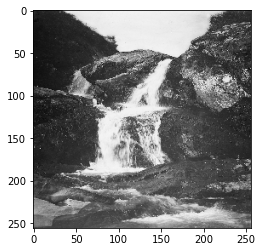

In [42]:
plt.imshow(X_L_test[0], cmap = "gray")

# Plotting old photographs

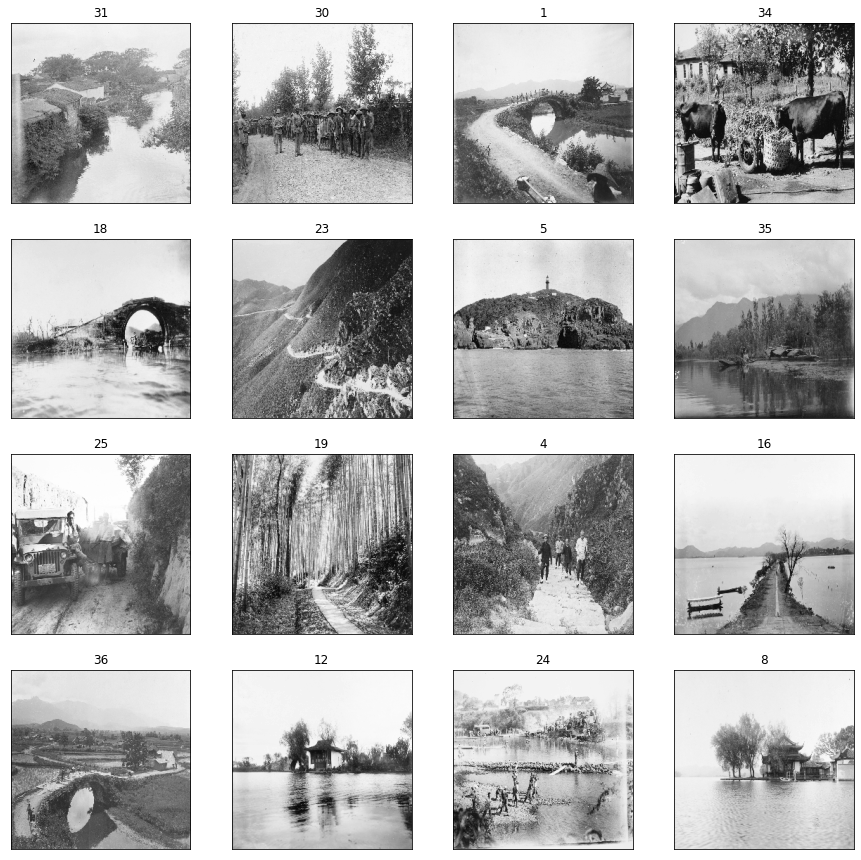

In [43]:
X_L_test_ = X_L_test.reshape(-1, image_size, image_size, 1)

fake_labels = np.array(list(range(len(X_L_test_))))
#
plot_dataset(X_L_test_ / 100., fake_labels, normalise = False)

# Colorising in batch

In [44]:
def colorise_images_batch(G, X_L, image_size):
    print("X_L.shape = ", X_L.shape)

    batch_size = X_L.shape[0]
    
    print("batch_size = ", batch_size)
    
    #to [-1, +1]
    X_L_norm = X_L / 50. - 1
    X_L_norm_batch = X_L_norm.reshape(-1, image_size, image_size, 1)
    
    print("X_L_norm.shape = ", X_L_norm.shape)
    print("X_L_norm_batch.shape = ", X_L_norm_batch.shape)

    X_ab_pred_norm_batch = G.predict(X_L_norm_batch) #.clip(-1, 1)

    print("X_ab_pred_norm_batch.shape = ", X_ab_pred_norm_batch.shape)
        
    # Combining L + ab to Lab images
    X_Lab_combined = np.zeros((batch_size, image_size, image_size, 3))

    print("X_Lab_combined.shape = ", X_Lab_combined.shape)

    X_L_batch = (X_L_norm_batch + 1) * 50
    X_ab_pred_batch = X_ab_pred_norm_batch * 110
    
    #X_Lab_norm_combined[:, :, :, 0] = X_L_norm_batch.reshape(batch_size, image_size, image_size)
    #X_Lab_norm_combined[:, :, :, 1:] = X_ab_pred_norm_batch.reshape(batch_size, image_size, image_size, 2)
    #de-normalising from [0, 1]
    #X_Lab_combined = (X_Lab_norm_combined + [1, 0, 0]) * [50, 110, 110]
    
    X_Lab_combined[:, :, :, 0] = X_L_batch.reshape(batch_size, image_size, image_size)
    X_Lab_combined[:, :, :, 1:] = X_ab_pred_batch.reshape(batch_size, image_size, image_size, 2)
    
    X_rgb_combined_norm = lab2rgb(X_Lab_combined).clip(0, 1)

    X_rgb_combined = X_rgb_combined_norm * 255
    
    print("X_rgb_combined.shape = ", X_rgb_combined.shape)
    
    return X_rgb_combined

# Choosing testing images

In [45]:
def choose_images_batch(X_L, image_size, num_images = None):

    if num_images is None:
        num_images = len(X_L)
    else:
        num_images = num_images if num_images < len(X_L) else len(X_L)
        

    print("X_L.shape = ", X_L.shape)
    print("num_images = ", num_images)

    indices = np.random.permutation(len(X_L))

    indices_ = np.random.choice(indices, num_images, replace = False)

    X_L_batch = X_L[indices_].reshape(-1, image_size, image_size, 1)
    
    return X_L_batch

In [46]:
#num_test_images = 16 if 16 <= len(X_L_test) else len(X_L_test)
#
#X_L_batch_test = choose_images_batch(X_L = X_L_test, 
#                                image_size = image_size,
#                                num_images = num_test_images)

X_L_batch_test = X_L_test

# Plotting photograph pairs

In [47]:
def plot_colorised_pairs(X_L,
                         X_rgb,
                         nrows = 4, 
                         subfig_width = 5,
                         subfig_height = 5):
    
    
    
    indices = list(range(len(X_L)))
    
    if len(X_L) < nrows * 2:
        replace = True
    else:
        replace = False
    
    indices_ = np.random.choice(indices, nrows * 2, replace = replace)
        
    #X_L_ = X_L[indices_]
    #X_rgb_ = X_rgb[indices_]
    
    figsize = (2 * subfig_width, nrows * subfig_height)

    fig, axes = plt.subplots(nrows = nrows,
                             ncols = 2,
                             figsize = figsize)

    axes_flat = axes.flat 

    for row in range(nrows):
        
        idx = 2 * row
        
        r"""
          L
        """
        
        ax = axes_flat[idx]
        
        ax.set_xticks([])
        ax.set_yticks([])
                
        imgidx = indices_[idx]
        
        image = X_L[imgidx] 
        label = f"Original #{row}"
            
        image = np.array(image)
                        
        image = image / 100
            
        ax.imshow(image, cmap = "gray", vmin = 0, vmax = 1)
        
        ax.title.set_text(f"{label}")
        
        r"""
          RGB
        """
        
        ax = axes_flat[idx + 1]
        
        ax.set_xticks([])
        ax.set_yticks([])
                
        imgidx = indices_[idx]
        
        image = X_rgb[imgidx] 
        label = f"Colorised #{row}"
            
        image = np.array(image) #.clip(0, 255)
                        
        image = image / 255
            
        ax.imshow(image, vmin = 0, vmax = 1)
        
        ax.title.set_text(f"{label}")             
            
    plt.show()

# Testing of colorising on training dataset

X_L.shape =  (30, 256, 256, 1)
batch_size =  30
X_L_norm.shape =  (30, 256, 256, 1)
X_L_norm_batch.shape =  (30, 256, 256, 1)
X_ab_pred_norm_batch.shape =  (30, 256, 256, 2)
X_Lab_combined.shape =  (30, 256, 256, 3)
X_rgb_combined.shape =  (30, 256, 256, 3)


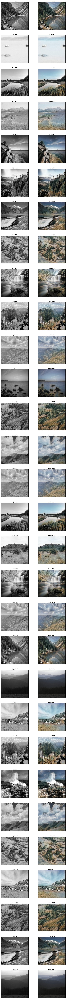

In [55]:
num_samples = 30
dataset_path = dataset_root + os.sep + "colorisation_train_images" 

test_datagen = ImageColorisationDataGenerator(
                                  dataset_path = dataset_path,
                                  batch_size = num_samples,
                                  image_size = image_size,
                                  training = False,
                                )

#from training dataset we sample multiple images without augmentation
X_L_batch_train, X_ab_batch_train = next(iter(test_datagen))
X_L_batch_train = (X_L_batch_train + 1) * 50

X_rgb_batch_train = colorise_images_batch(G_, X_L_batch_train, image_size)

num_rows = num_samples if len(X_L_batch_train) >= num_samples else len(X_L_batch_train)

plot_colorised_pairs(X_L_batch_train,
                     X_rgb_batch_train,
                     nrows = num_rows, 
                     subfig_width = 8,
                     subfig_height = 8)

# Testing of colorising on old photographs

Loading from datasets/colorisation_test_images ...
Loading 41 - datasets/colorisation_test_images/China/wi02-07.jpgg
Loading finished.
X_L.shape =  (41, 256, 256)
batch_size =  41
X_L_norm.shape =  (41, 256, 256)
X_L_norm_batch.shape =  (41, 256, 256, 1)
X_ab_pred_norm_batch.shape =  (41, 256, 256, 2)
X_Lab_combined.shape =  (41, 256, 256, 3)
X_rgb_combined.shape =  (41, 256, 256, 3)


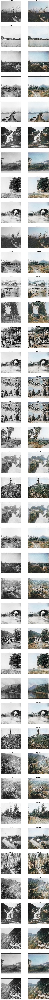

In [51]:
dataset_path = dataset_root + os.sep + "colorisation_test_images"

X_L_batch_test = load_test_image_files(
                          dataset_path, 
                          image_size = 256,
                          max_num_of_images = 128, #None 
                     )

X_rgb_batch_test = colorise_images_batch(G_, X_L_batch_test, image_size)

num_test_images = 40

num_rows = num_test_images if len(X_L_batch_test) >= num_test_images else len(X_L_batch_test)

plot_colorised_pairs(X_L_batch_test,
                     X_rgb_batch_test,
                     nrows = num_rows, 
                     subfig_width = 8,
                     subfig_height = 8)